In [ ]:
import os
import numpy as np
import time
import torch
import random
import pickle
import torch.nn.functional as F
from torch.optim.lr_scheduler import StepLR
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
import torchvision
from torch import nn ,optim
from torchvision.utils import save_image
import torchvision.transforms as transforms
from torch.utils.data import  DataLoader,Dataset,random_split

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
os.makedirs('/content/drive/MyDrive/data/', exist_ok=True)

Mounted at /content/drive


## data

In [ ]:
whole_data='/content/drive/MyDrive/data'
import os
def walk_through_dir(dir_path):
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")
walk_through_dir(whole_data)

There are 2 directories and 0 images in '/content/drive/MyDrive/data'.
There are 0 directories and 12030 images in '/content/drive/MyDrive/data/test'.
There are 2 directories and 0 images in '/content/drive/MyDrive/data/train'.
There are 0 directories and 603 images in '/content/drive/MyDrive/data/train/non_smile'.
There are 0 directories and 600 images in '/content/drive/MyDrive/data/train/smile'.


In [ ]:
import os
train_non_smiling_path = '/content/drive/MyDrive/VAE data/data/train/non_smile'
train_smiling_path='/content/drive/MyDrive/VAE data/data/train/smile'
#test_non_smiling_path = '/content/drive/MyDrive/VAE data/data/test/non_smile'
test_path='/content/drive/MyDrive/data/test'
for i,x in zip([train_non_smiling_path,train_smiling_path,test_path],['train_non_smiling','train_smiling','test']):
  file_count = len([name for name in os.listdir(i) if os.path.isfile(os.path.join(i, name))])
  print(f'Number of imgs in {x}: {file_count}')

FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/VAE data/data/train/non_smile'

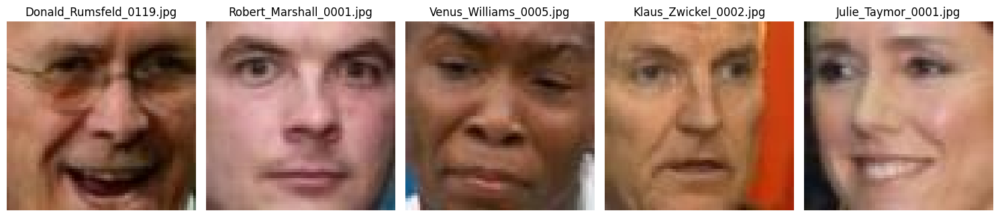

In [ ]:
import random
from PIL import Image
random.seed(42)
test_path='/content/drive/MyDrive/data/test'
image_files = [f for f in os.listdir(test_path) if f.endswith('.jpg')]
random_images = random.sample(image_files, 5)

plt.figure(figsize=(15, 10))
for i, image_file in enumerate(random_images):
    image_path = os.path.join(test_path, image_file)
    img = Image.open(image_path)
    plt.subplot(1, 5, i + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(image_file)

plt.tight_layout()
plt.show()

## data preprocessing

In [ ]:
class FaceDataset(Dataset):
  def __init__(self, root_dirs, transform=None):
    self.root_dirs = root_dirs
    self.transform = transform
    self.image_paths = []
    for root_dir in root_dirs:
      self.image_paths += [os.path.join(root_dir, img) for img in os.listdir(root_dir) if img.endswith(('.jpg', '.png', '.jpeg'))]

  def __len__(self):
    return len(self.image_paths)
  def __getitem__(self, idx):
      img_path = self.image_paths[idx]
      image = Image.open(img_path).convert('RGB')
      if self.transform:
          image = self.transform(image)
      return image

transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
]    )

In [ ]:
batch_size = 128
#test_path='/content/drive/MyDrive/data (1)/test' #sam.sololuki
#test_path='/content/drive/MyDrive/VAE data/data/test' #samdeep01-2 - saminsolouki
"""
train_path_classA = '/content/drive/MyDrive/VAE data/data/train/non_smile'
train_path_classB = '/content/drive/MyDrive/VAE data/data/train/smile'
"""
#test_path='/content/drive/MyDrive/data/test' #slk878
train_path_classA='/content/drive/MyDrive/data/train/non_smile'
train_path_classB='/content/drive/MyDrive/data/train/smile'
face_dataset = FaceDataset(root_dirs=[train_path_classA , train_path_classB], transform=transform)
#face_dataset = FaceDataset(root_dir=test_path, transform=transform)
train_size = int(0.8 * len(face_dataset))
val_size = int(0.1 * len(face_dataset))
test_size = len(face_dataset) - (train_size + val_size)

sizes = [train_size, val_size,test_size]
train_dataset, val_dataset , test_dataset= random_split(face_dataset, sizes)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

In [ ]:
face_dataset[0].shape

torch.Size([3, 128, 128])

In [ ]:
print (f'Using {len(train_loader)*batch_size} data points in {len(val_loader)} batches for Training.\n Using {len(val_loader)*batch_size} data points in {len(train_loader)} batches for Validation.')

Using 1024 data points in 1 batches for Training.
 Using 128 data points in 8 batches for Validation.


## a sample from data

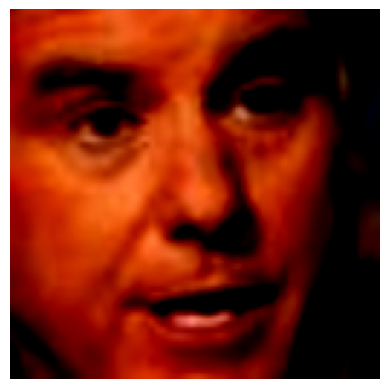

In [ ]:
data_iter = iter(data_loader)
images = next(data_iter)
idx = random.randint(0, len(images) - 1)
random_image = images[idx]
#random_image = random_image * 0.5 + 0.5  #unnormalize
plt.imshow(random_image.permute(1, 2, 0))
plt.axis('off')
plt.show()

## class VAE

In [ ]:
class Reshape(nn.Module):
    def __init__(self, *args):
        super().__init__()
        self.shape = args

    def forward(self, x):
        return x.view(self.shape)


class Trim(nn.Module):
    def __init__(self, *args):
        super().__init__()

    def forward(self, x):
        return x[:, :, :128, :128]



class VAE(nn.Module):
  def __init__(self):
    super().__init__()

    self.encoder = nn.Sequential(
              nn.Conv2d(3, 32, stride=2, kernel_size=4, bias=False, padding=1),
              nn.BatchNorm2d(32),
              nn.ReLU(inplace=True),
              nn.Dropout2d(0.25),
              nn.Conv2d(32, 64, stride=2, kernel_size=4, bias=False, padding=1),
              nn.BatchNorm2d(64),
              nn.ReLU(inplace=True),
              nn.Dropout2d(0.25),
              nn.Conv2d(64, 64, stride=2, kernel_size=4, bias=False, padding=1),
              nn.BatchNorm2d(64),
              nn.ReLU(inplace=True),
              nn.Dropout2d(0.25),
              nn.Conv2d(64, 64, stride=2, kernel_size=4, bias=False, padding=1),
              nn.BatchNorm2d(64),
              nn.ReLU(inplace=True),
              nn.Dropout2d(0.25),
              nn.Flatten(),      )

    self.z_mean = torch.nn.Linear(4096, 120)
    self.z_log_var = torch.nn.Linear(4096, 120)

    self.decoder = nn.Sequential(
              torch.nn.Linear(120, 4096),
              Reshape(-1, 64, 8, 8),
              nn.ConvTranspose2d(64, 64, stride=2, kernel_size=4),
              nn.BatchNorm2d(64),
              nn.ReLU(inplace=True),
              nn.Dropout2d(0.25),
              nn.ConvTranspose2d(64, 64, stride=2, kernel_size=4, padding=1),
              nn.BatchNorm2d(64),
              nn.ReLU(inplace=True),
              nn.Dropout2d(0.25),
              nn.ConvTranspose2d(64, 32, stride=2, kernel_size=4, padding=1),
              nn.BatchNorm2d(32),
              nn.ReLU(inplace=True),
              nn.Dropout2d(0.25),
              nn.ConvTranspose2d(32, 3, stride=2, kernel_size=4, padding=1),
              Trim(),
              nn.Sigmoid()              )


  def encoding_fn(self, x):
    x = self.encoder(x)
    z_mean, z_log_var = self.z_mean(x), self.z_log_var(x)
    encoded = self.reparameterize(z_mean, z_log_var)
    return encoded


  def reparameterize(self, z_mu, z_log_var):
    eps= torch.randn(z_mu.size(0), z_mu.size(1))
    z= z_mu+eps*torch.exp(z_log_var/2.)
    return z

  def forward(self, x):
    x= self.encoder(x)
    z_mean, z_log_var = self.z_mean(x), self.z_log_var(x)
    encoded_X = self.reparameterize(z_mean, z_log_var)
    decoded = self.decoder(encoded_X)
    return encoded_X, z_mean, z_log_var, decoded

## train function

In [ ]:
def Train_VAE(num_epochs, model, optimizer,
                 train_loader,val_loader,loss_fn=None,
                 logging_interval=100,
                 skip_epoch_stats=False,
                 #reconstruction_term_weight=1,
                 save_model=None,beta=10):

    if loss_fn is None:
        loss_fn = F.mse_loss

    start_time = time.time()

    log_dict = {'train_combined_loss_per_batch': [],
            'train_reconstruction_loss_per_batch': [],
            'train_kl_loss_per_batch': [],

            'train_combined_loss_per_epoch': [],
            'val_combined_loss_per_epoch': [],
            'val_reconstruction_loss_per_epoch': [],
            'val_kl_loss_per_per_epoch': []
            }
    for epoch in range(num_epochs):
        model.train()
        for batch_idx, features in enumerate(train_loader):
            encoded, z_mean, z_log_var, decoded = model(features)
 #KL Loss
            kl_div = -0.5 * torch.sum(1 + z_log_var- z_mean**2-torch.exp(z_log_var), axis=1)
           # batchsize = kl_div.size(0)
            kl_div = kl_div.mean()

#Recostruction Loss
            batchsize = features.size(0)
            pixelwise = loss_fn(decoded, features, reduction='none')
            pixelwise_loss = pixelwise.view(batchsize, -1).sum(axis=1).mean()

            loss = pixelwise_loss + kl_div*beta
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            log_dict['train_combined_loss_per_batch'].append(loss.item())
            log_dict['train_reconstruction_loss_per_batch'].append(pixelwise_loss.item())
            log_dict['train_kl_loss_per_batch'].append(kl_div.item())

        model.eval()
        val_loss_pixelwise_val,val_loss_kl_div_val=[],[]
        with torch.no_grad():
            for val_features in val_loader:
                encoded, z_mean, z_log_var, decoded = model(val_features)
                kl_div_val = -0.5 * torch.sum(1 + z_log_var - z_mean**2 - torch.exp(z_log_var), axis=1).mean()

                pixelwise_val = loss_fn(decoded, val_features, reduction='none').view(val_features.size(0), -1).sum(axis=1).mean()

                val_loss_pixelwise_val.append((pixelwise_val ).item())
                val_loss_kl_div_val.append((kl_div_val).item())

            aa=np.mean(val_loss_pixelwise_val)
            log_dict['val_reconstruction_loss_per_epoch'].append(aa)
            bb=np.mean(val_loss_kl_div_val)
            log_dict['val_kl_loss_per_per_epoch'].append(bb)
            log_dict['val_combined_loss_per_epoch'].append(aa+bb*beta)
            scheduler.step(aa+bb)

            print('***Epoch: %03d/%03d | Sigma Loss: %.3f  | Validation Loss:%.3f' % (epoch+1, num_epochs, loss,aa+bb))

        if  (save_model is not None):
            epoch_save_path = "/content/drive/MyDrive/VAE_epoch_" + str(epoch + 1) + ".pt"
            torch.save(model.state_dict(), epoch_save_path)
            save_dict_path =  '/content/drive/MyDrive/VAE_Results'+str(epoch + 1) + '.pkl'
            with open(save_dict_path, 'wb') as f: pickle.dump(log_dict, f)

        current_lr = optimizer.param_groups[0]['lr']
        print(f'Epoch: {epoch + 1}/{num_epochs}, Learning Rate: {current_lr:.6f}')
        print('Time elapsed: %.2f min' % ((time.time() - start_time)/60))

    print('Total Training Time: %.2f min' % ((time.time() - start_time)/60))

    return log_dict


## Final training

## Good1

In [ ]:
from torch.optim.lr_scheduler import ReduceLROnPlateau

torch.manual_seed(42)
model = VAE()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)
log_dict = Train_VAE(num_epochs=150, model=model,
                      optimizer=optimizer,
                      train_loader=train_loader,
                      val_loader=val_loader,
                      save_model=1,beta=1)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


***Epoch: 001/150 | Sigma Loss: 19405.090  | Validation Loss:19847.979
Epoch: 1/150, Learning Rate: 0.000500
Time elapsed: 4.35 min
***Epoch: 002/150 | Sigma Loss: 14917.809  | Validation Loss:19786.414
Epoch: 2/150, Learning Rate: 0.000500
Time elapsed: 5.01 min
***Epoch: 003/150 | Sigma Loss: 12108.589  | Validation Loss:15167.367
Epoch: 3/150, Learning Rate: 0.000500
Time elapsed: 5.68 min
***Epoch: 004/150 | Sigma Loss: 10838.658  | Validation Loss:11691.558
Epoch: 4/150, Learning Rate: 0.000500
Time elapsed: 6.35 min
***Epoch: 005/150 | Sigma Loss: 9123.160  | Validation Loss:8837.776
Epoch: 5/150, Learning Rate: 0.000500
Time elapsed: 7.05 min
***Epoch: 006/150 | Sigma Loss: 9207.918  | Validation Loss:8515.852
Epoch: 6/150, Learning Rate: 0.000500
Time elapsed: 7.71 min
***Epoch: 007/150 | Sigma Loss: 8192.359  | Validation Loss:7504.233
Epoch: 7/150, Learning Rate: 0.000500
Time elapsed: 8.37 min
***Epoch: 008/150 | Sigma Loss: 8509.747  | Validation Loss:7246.421
Epoch: 8/150,

In [ ]:
model_path = '/content/drive/MyDrive/VAE_epoch_59.pt'
model=VAE()
model.load_state_dict(torch.load(model_path))
model.eval()

<ipython-input-11-436d1c47d96f>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


VAE(
  (encoder): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Dropout2d(p=0.25, inplace=False)
    (4): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Dropout2d(p=0.25, inplace=False)
    (8): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): Dropout2d(p=0.25, inplace=False)
    (12): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (14): ReLU(inplace=True)
    (15): Dropout2d(p=0.

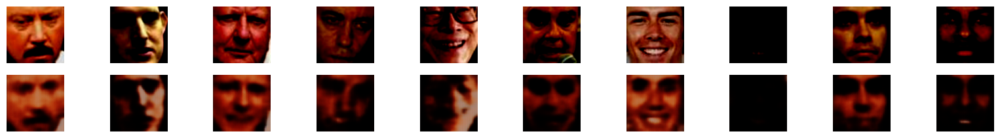

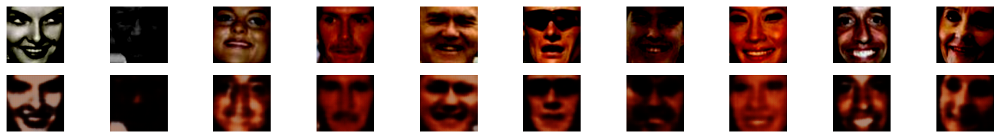

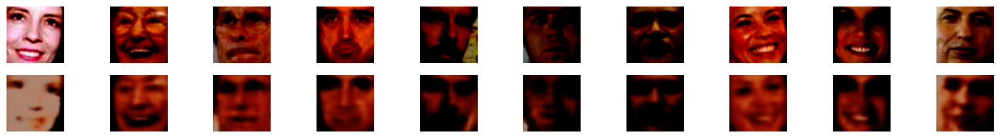

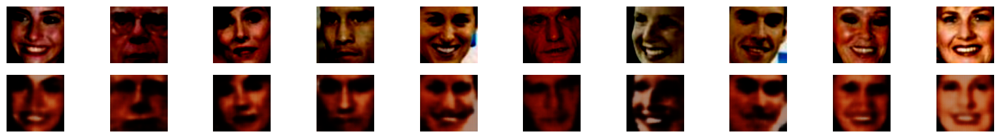

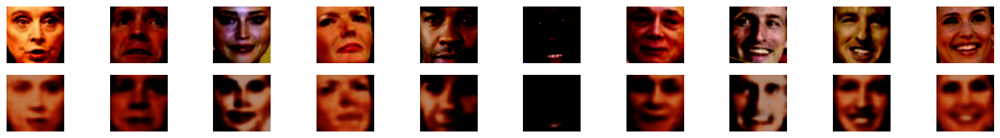

...

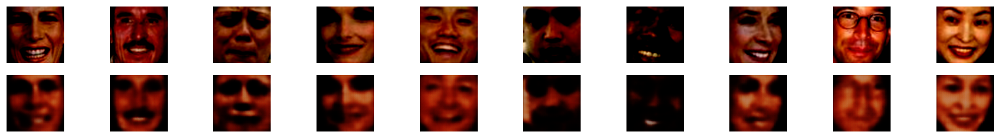

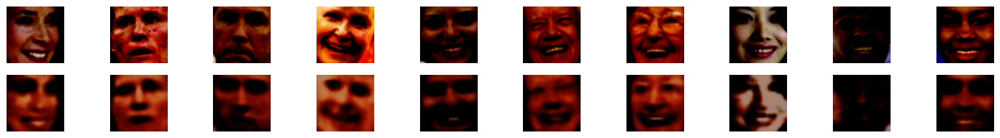

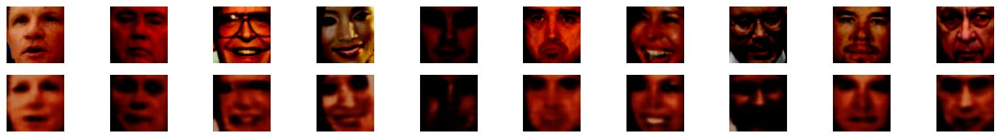

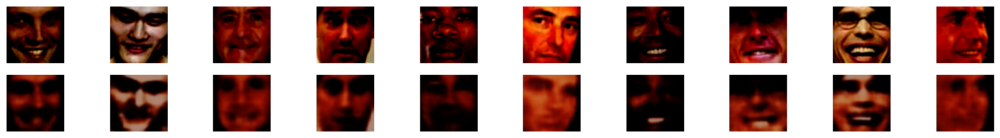

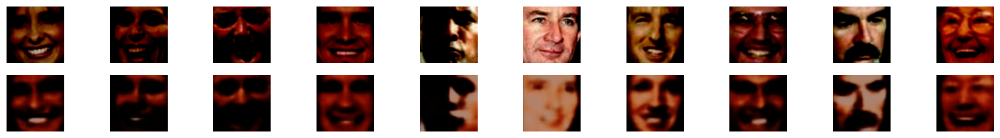

In [ ]:
for i in range(15):
    plot_generated_images(data_loader=train_loader,model=model,n_images=10)
    plt.show()

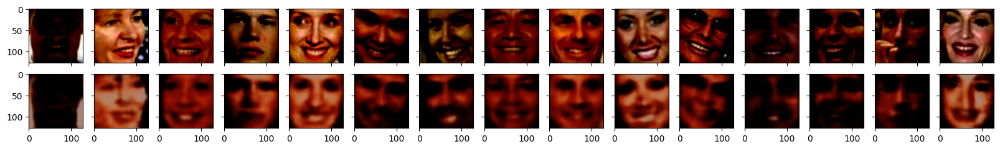

In [ ]:
plot_generated_images(data_loader=train_loader,model=model)

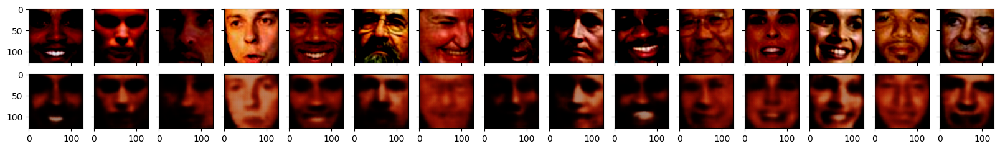

In [ ]:
plot_generated_images(data_loader=test_loader,
                     model=model )

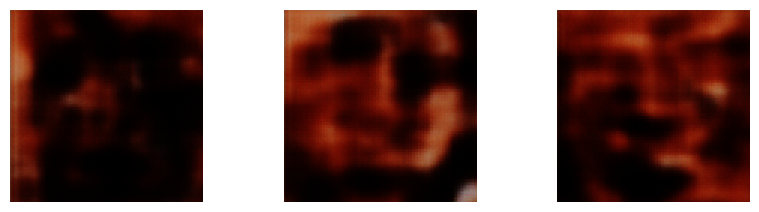

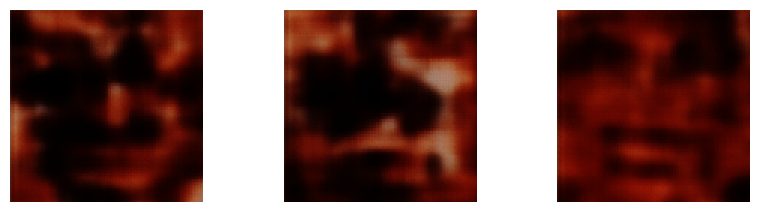

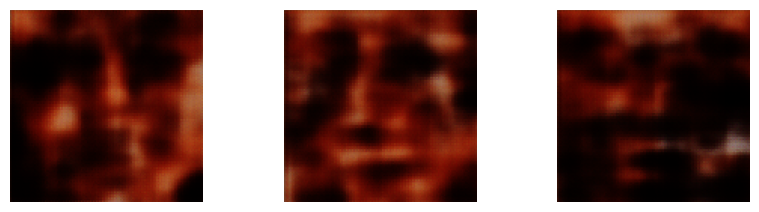

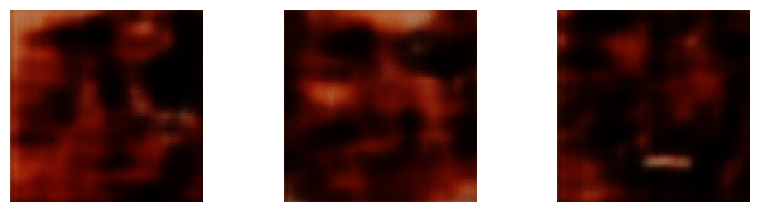

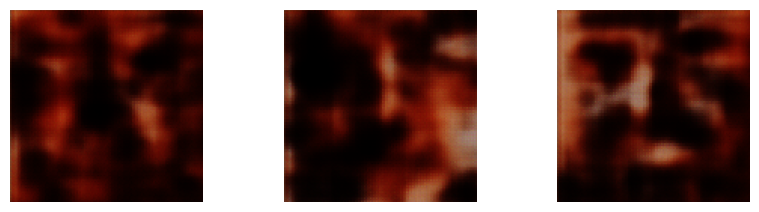

In [ ]:
for i in range(5):
    plot_images_sampled_from_vae(model=model,latent_size=120)
    plt.show()

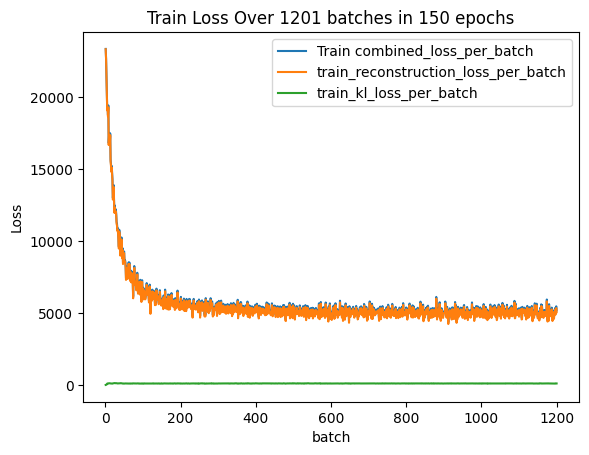

In [ ]:
import pickle

# Specify the path to your .pkl file
file_path = '/content/drive/MyDrive/VAE_Results150.pkl'

# Load the pickle file
with open(file_path, 'rb') as file:
    log_dict = pickle.load(file)

train_losses_com = log_dict['train_combined_loss_per_batch']
val_losses_recons = log_dict['train_reconstruction_loss_per_batch']
val_losses_kl = log_dict['train_kl_loss_per_batch']

epochs = range(1, len(val_losses_kl) + 1)

plt.plot(epochs, train_losses_com, label='Train combined_loss_per_batch')
plt.plot(epochs, val_losses_recons, label='train_reconstruction_loss_per_batch')
plt.plot(epochs, val_losses_kl, label='train_kl_loss_per_batch')
plt.xlabel('batch')
plt.ylabel('Loss')
x=len(log_dict['val_kl_loss_per_per_epoch'])
plt.title(f'Train Loss Over {1+(len(val_losses_kl))} batches in {x} epochs')
plt.legend()
plt.show()


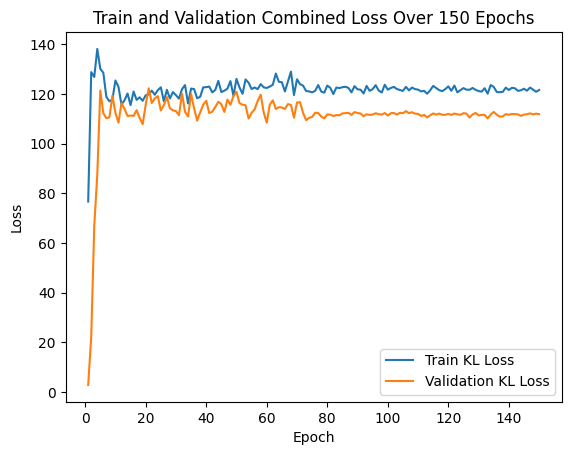

In [ ]:
list_1 = log_dict['train_kl_loss_per_batch']
train_kl_loss_per_epoch= [np.mean(list_1[i:i + 8]) for i in range(0, len(list_1), 8)]
val_kl_loss_per_per_epoch =log_dict['val_kl_loss_per_per_epoch']
epochs = range(1, 1+len(val_kl_loss_per_per_epoch))
plt.plot(epochs, train_kl_loss_per_epoch, label='Train KL Loss')
plt.plot(epochs, val_kl_loss_per_per_epoch, label='Validation KL Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Train and Validation KL Loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


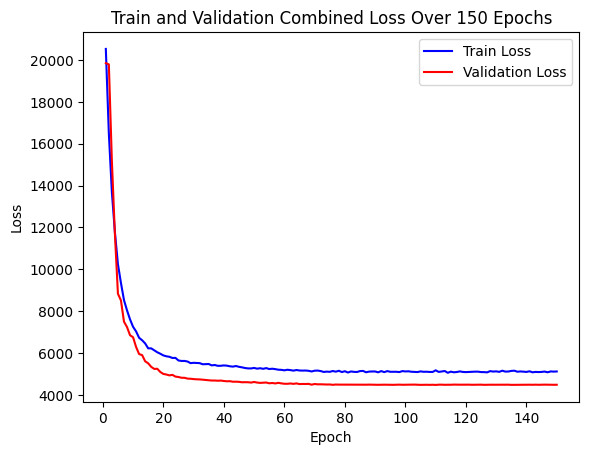

In [ ]:
import matplotlib.pyplot as plt
list_1=log_dict['train_combined_loss_per_batch']
traincombined_loss_per_epoch= [np.mean(list_1[i:i + 8]) for i in range(0, len(list_1), 8)]

val__combinedlosses =log_dict['val_combined_loss_per_epoch']
epochs = range(1,1+(len(val__combinedlosses)))
log_dict_train_combined_loss_per_epoch=  log_dict['train_reconstruction_loss_per_batch']+log_dict[ 'train_kl_loss_per_batch']
plt.plot(epochs, traincombined_loss_per_epoch, label='Train Loss', color='b')
plt.plot(epochs, val__combinedlosses, label='Validation Loss',color='r')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Train and Validation Combined Loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


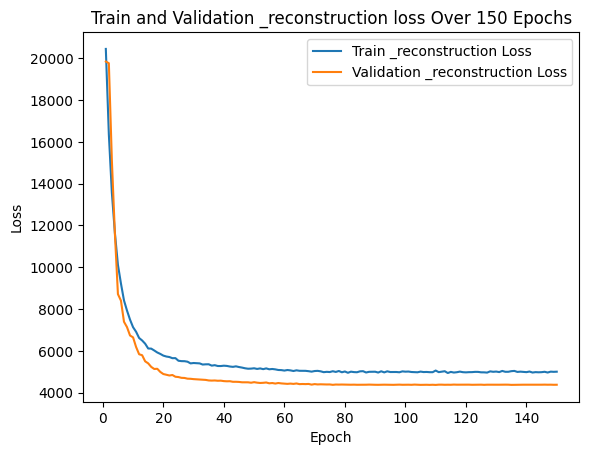

In [ ]:
import matplotlib.pyplot as plt

list_1 = log_dict[ 'train_reconstruction_loss_per_batch']  # Replace with your training loss list
train_kl_loss_per_epoch= [np.mean(list_1[i:i + 8]) for i in range(0, len(list_1), 8)]#[:99]

val_kl_loss_per_per_epoch =log_dict['val_reconstruction_loss_per_epoch']
epochs = range(1, len(val_kl_loss_per_per_epoch)+1)

plt.plot(epochs, train_kl_loss_per_epoch, label='Train _reconstruction Loss')
plt.plot(epochs, val_kl_loss_per_per_epoch, label='Validation _reconstruction Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Train and Validation _reconstruction loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


In [ ]:
log_dict.keys()

dict_keys(['train_combined_loss_per_batch', 'train_reconstruction_loss_per_batch', 'train_kl_loss_per_batch', 'train_combined_loss_per_epoch', 'val_combined_loss_per_epoch', 'val_reconstruction_loss_per_epoch', 'val_kl_loss_per_per_epoch'])

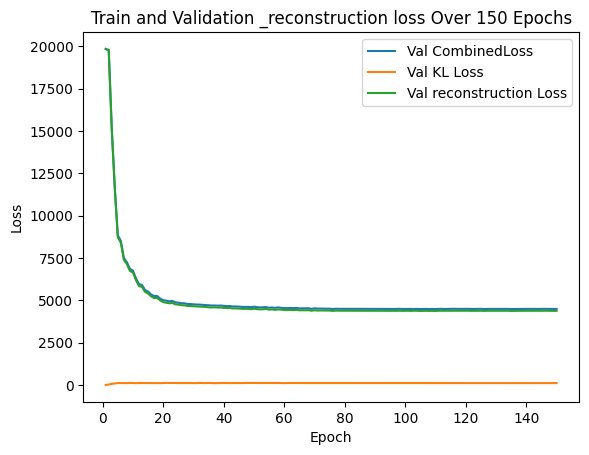

In [ ]:
epochs=range(1,1+len(val_kl_loss_per_per_epoch))
plt.plot(epochs, log_dict['val_combined_loss_per_epoch'], label='Val CombinedLoss')
plt.plot(epochs,log_dict['val_kl_loss_per_per_epoch'], label='Val KL Loss')
plt.plot(epochs, log_dict['val_reconstruction_loss_per_epoch'], label='Val reconstruction Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Validation loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


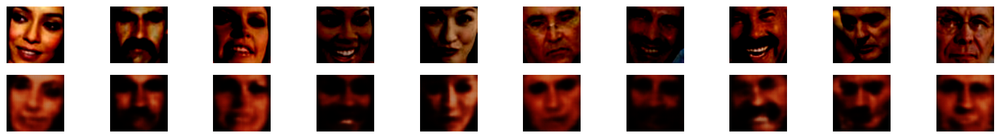

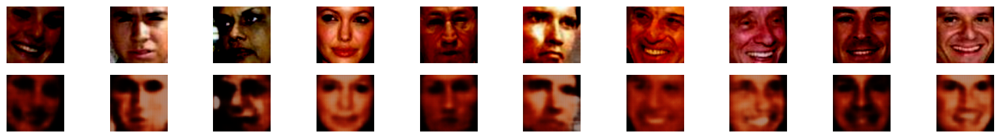

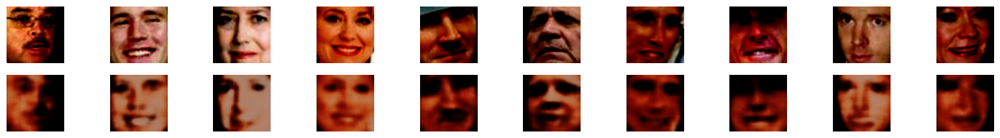

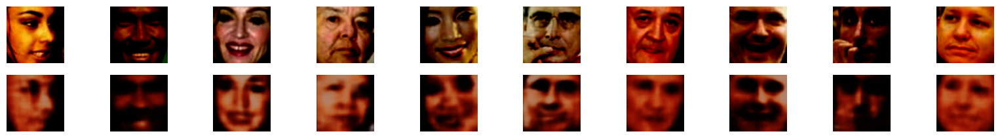

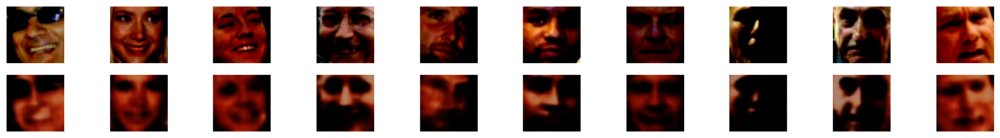

In [ ]:
for i in range(5):
    plot_generated_images(data_loader=train_loader,model=model,n_images=10)
    plt.show()

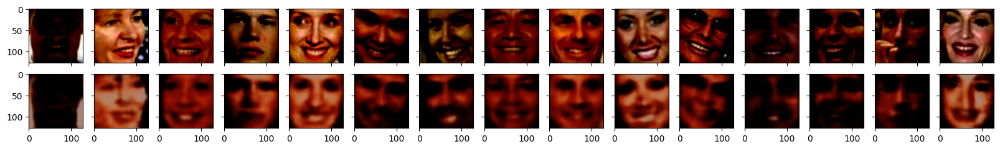

In [ ]:
plot_generated_images(data_loader=train_loader,model=model)

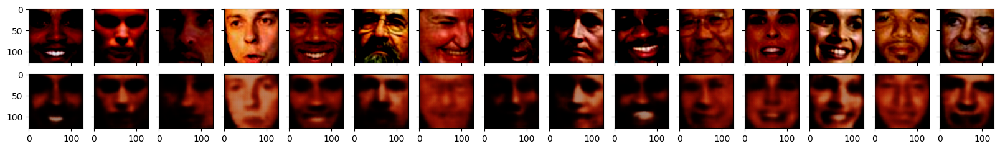

In [ ]:
plot_generated_images(data_loader=test_loader,
                     model=model )

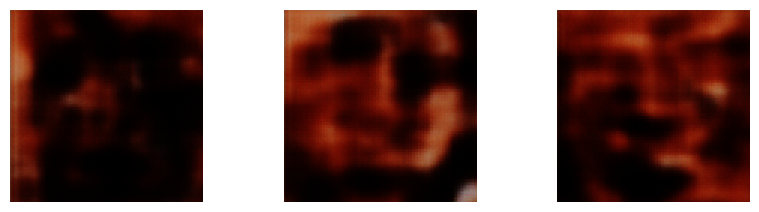

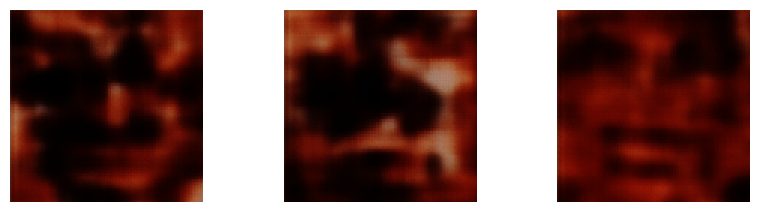

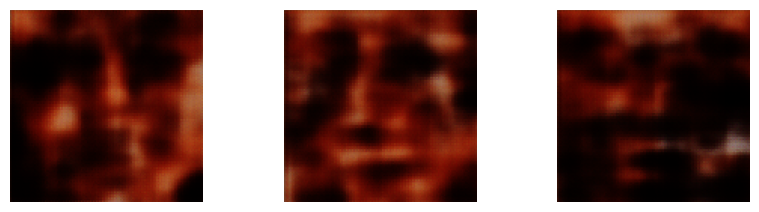

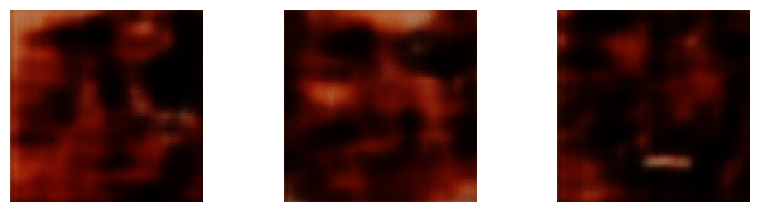

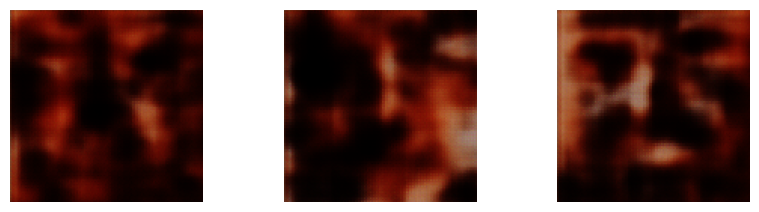

In [ ]:
for i in range(5):
    plot_images_sampled_from_vae(model=model,latent_size=120)
    plt.show()

## GOOD2

In [ ]:
from torch.optim.lr_scheduler import ReduceLROnPlateau

torch.manual_seed(42)
model = VAE()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)
log_dict = Train_VAE(num_epochs=200, model=model,
                      optimizer=optimizer,
                      train_loader=train_loader,
                      val_loader=val_loader,
                      save_model=1,beta=1)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


***Epoch: 001/200 | Sigma Loss: 1031.941  | Validation Loss:1088.580
Epoch: 1/200, Learning Rate: 0.000500
Time elapsed: 8.21 min
***Epoch: 002/200 | Sigma Loss: 781.626  | Validation Loss:827.178
Epoch: 2/200, Learning Rate: 0.000500
Time elapsed: 8.63 min
***Epoch: 003/200 | Sigma Loss: 1433.772  | Validation Loss:713.538
Epoch: 3/200, Learning Rate: 0.000500
Time elapsed: 9.06 min
***Epoch: 004/200 | Sigma Loss: 1195.063  | Validation Loss:658.094
Epoch: 4/200, Learning Rate: 0.000500
Time elapsed: 9.49 min
***Epoch: 005/200 | Sigma Loss: 1191.467  | Validation Loss:636.352
Epoch: 5/200, Learning Rate: 0.000500
Time elapsed: 9.90 min
***Epoch: 006/200 | Sigma Loss: 1072.782  | Validation Loss:612.147
Epoch: 6/200, Learning Rate: 0.000500
Time elapsed: 10.32 min
***Epoch: 007/200 | Sigma Loss: 578.207  | Validation Loss:596.086
Epoch: 7/200, Learning Rate: 0.000500
Time elapsed: 10.74 min
***Epoch: 008/200 | Sigma Loss: 605.154  | Validation Loss:584.794
Epoch: 8/200, Learning Rate: 

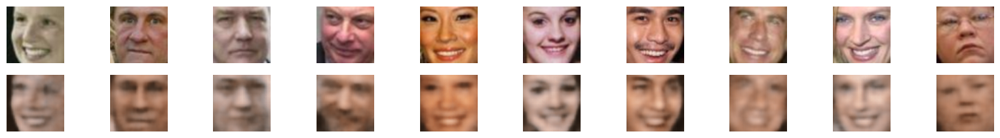

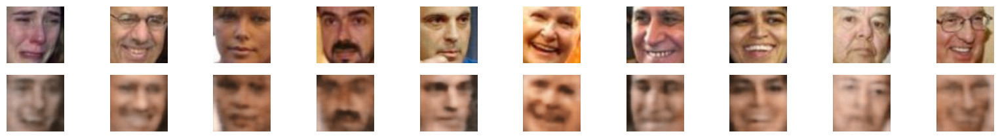

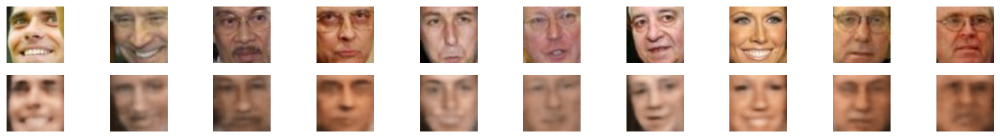

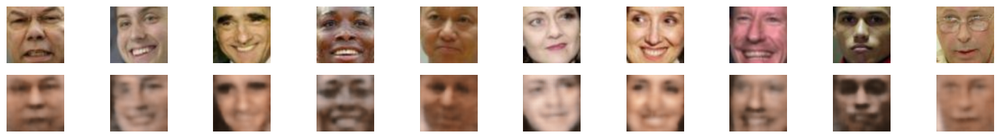

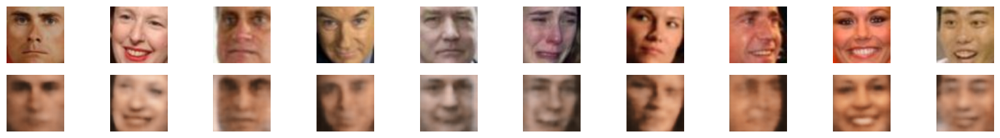

...

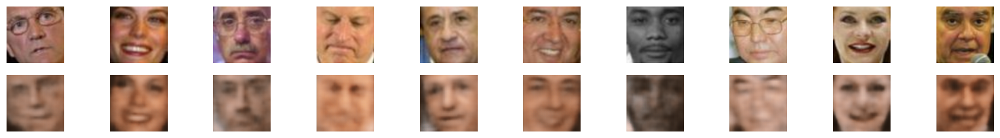

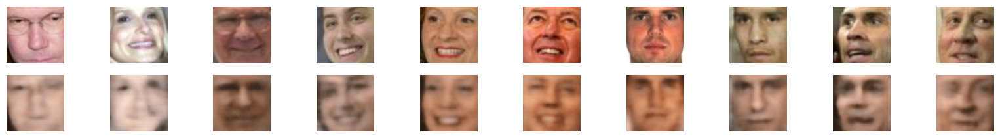

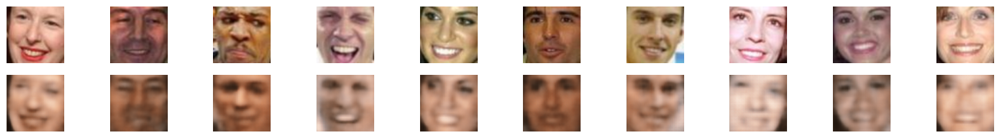

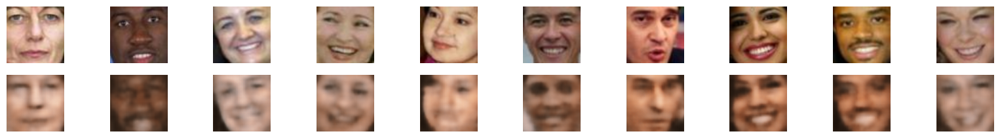

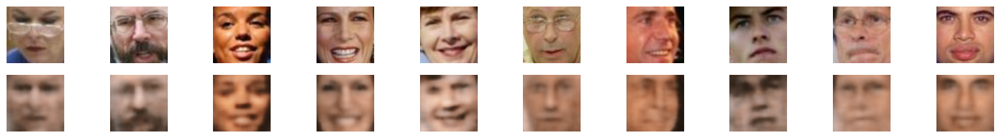

In [ ]:
for i in range (20): plot_generated_images(data_loader=train_loader, model=model)

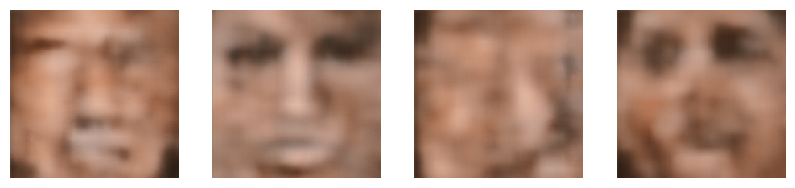

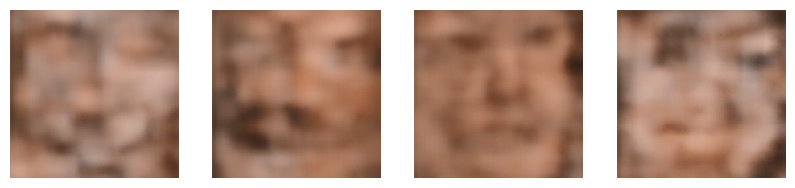

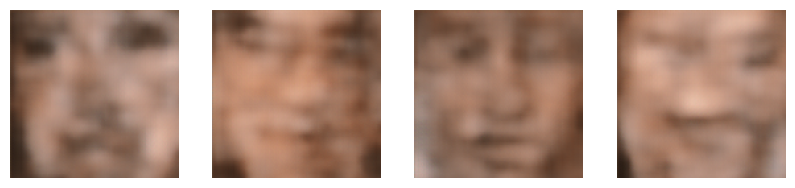

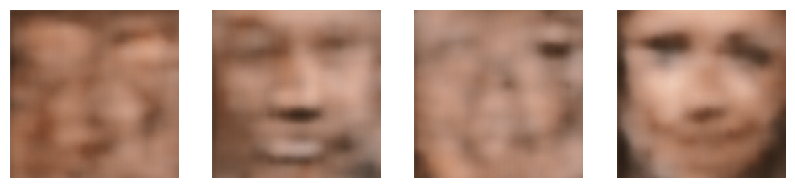

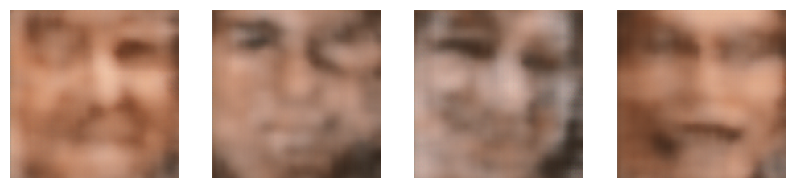

...

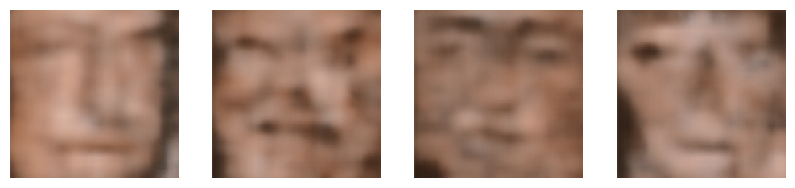

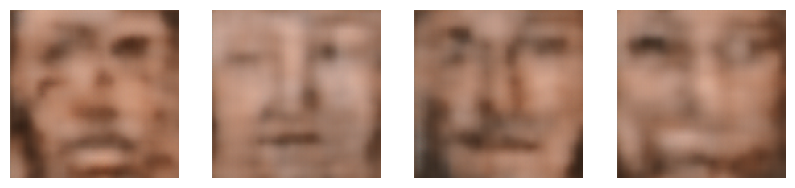

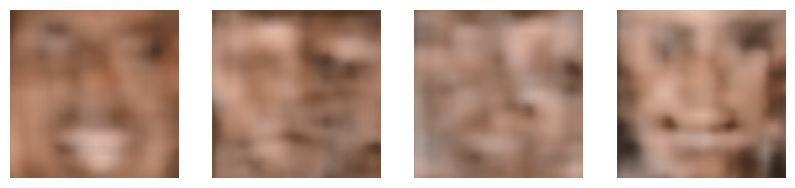

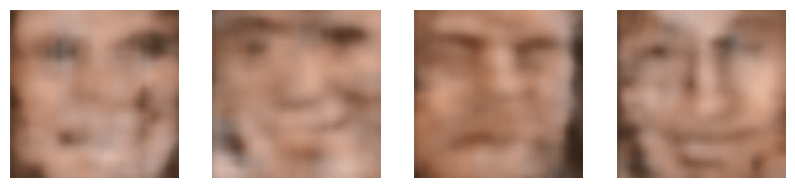

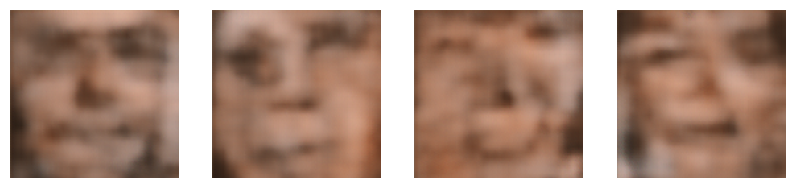

In [ ]:
for i in range(20):
    plot_images_sampled_from_vae(model=model,latent_size=120)
    plt.show()

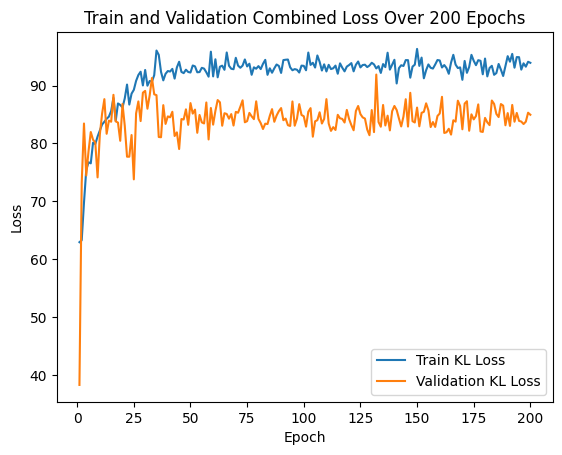

In [ ]:
list_1 = log_dict['train_kl_loss_per_batch']
train_kl_loss_per_epoch= [np.mean(list_1[i:i + 30]) for i in range(0, len(list_1), 30)][:200]
val_kl_loss_per_per_epoch =log_dict['val_kl_loss_per_per_epoch']
epochs = range(1, 1+len(val_kl_loss_per_per_epoch))
plt.plot(epochs, train_kl_loss_per_epoch, label='Train KL Loss')
plt.plot(epochs, val_kl_loss_per_per_epoch, label='Validation KL Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Train and Validation KL Loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


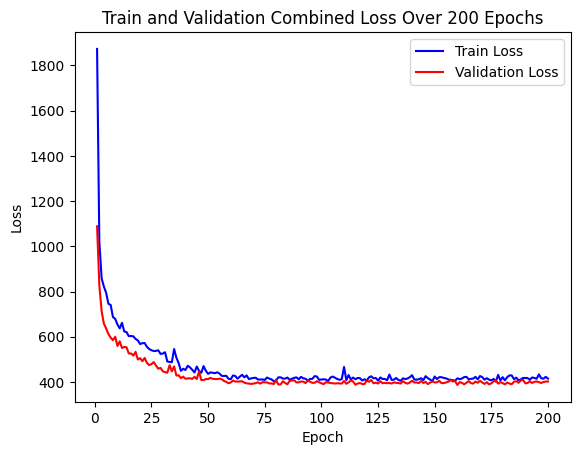

In [ ]:
import matplotlib.pyplot as plt
list_1=log_dict['train_combined_loss_per_batch']
traincombined_loss_per_epoch= [np.mean(list_1[i:i + 30]) for i in range(0, len(list_1), 30)][:200]

val__combinedlosses =log_dict['val_combined_loss_per_epoch']
epochs = range(1,1+(len(val__combinedlosses)))
log_dict_train_combined_loss_per_epoch=  log_dict['train_reconstruction_loss_per_batch']+log_dict[ 'train_kl_loss_per_batch']
plt.plot(epochs, traincombined_loss_per_epoch, label='Train Loss', color='b')
plt.plot(epochs, val__combinedlosses, label='Validation Loss',color='r')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Train and Validation Combined Loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


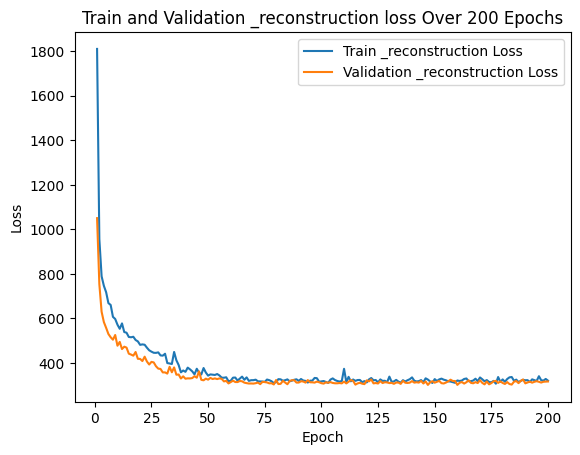

In [ ]:
import matplotlib.pyplot as plt

list_1 = log_dict[ 'train_reconstruction_loss_per_batch']  # Replace with your training loss list
train_kl_loss_per_epoch= [np.mean(list_1[i:i + 30]) for i in range(0, len(list_1), 30)][:200]

val_kl_loss_per_per_epoch =log_dict['val_reconstruction_loss_per_epoch']
epochs = range(1, len(val_kl_loss_per_per_epoch)+1)

plt.plot(epochs, train_kl_loss_per_epoch, label='Train _reconstruction Loss')
plt.plot(epochs, val_kl_loss_per_per_epoch, label='Validation _reconstruction Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Train and Validation _reconstruction loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


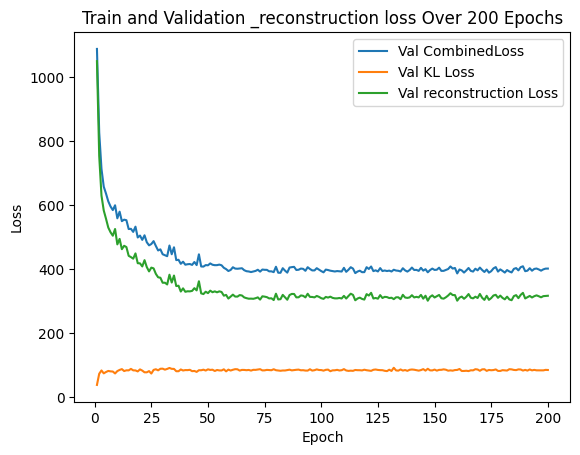

In [ ]:
epochs=range(1,1+len(val_kl_loss_per_per_epoch))
plt.plot(epochs, log_dict['val_combined_loss_per_epoch'], label='Val CombinedLoss')
plt.plot(epochs,log_dict['val_kl_loss_per_per_epoch'], label='Val KL Loss')
plt.plot(epochs, log_dict['val_reconstruction_loss_per_epoch'], label='Val reconstruction Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title(f'Train and Validation _reconstruction loss Over {len(epochs)} Epochs')
plt.legend()
plt.show()


## plot

In [ ]:
import numpy as np
import os
import torch
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors


def plot_generated_images(data_loader, model,
                        unnormalizer=None,
                        figsize=(20, 2.5), n_images=15):

  fig, axes = plt.subplots(nrows=2, ncols=n_images,
                            sharex=True, sharey=True, figsize=figsize)

  for batch_idx, features in enumerate(data_loader):

    color_channels = features.shape[1]
    image_height = features.shape[2]
    image_width = features.shape[3]

    encoded, z_mean, z_log_var, decoded_images = model(features)[:n_images]
    orig_images = features[:n_images]
    break

  for i in range(n_images):
    for ax, img in zip(axes, [orig_images, decoded_images]):
      curr_img = img[i].detach()
      if unnormalizer is not None:
        curr_img = unnormalizer(curr_img)

      if color_channels > 1:
        curr_img = np.transpose(curr_img, (1, 2, 0))
        ax[i].imshow(curr_img)
        ax[i].axis('off')

      else:
        ax[i].imshow(curr_img.view((image_height, image_width)), cmap='binary')
        ax[i].axis('off')



def plot_images_sampled_from_vae(model, latent_size=200, unnormalizer=None, num_images=3):

  with torch.no_grad():


    rand_features = torch.randn(num_images, latent_size)
    new_images = model.decoder(rand_features)
    color_channels = new_images.shape[1]
    image_height = new_images.shape[2]
    image_width = new_images.shape[3]


    image_width = 64

    fig, axes = plt.subplots(nrows=1, ncols=num_images, figsize=(10, 2.5), sharey=True)
    decoded_images = new_images[:num_images]

    for ax, img in zip(axes, decoded_images):
      curr_img = img.detach()
      if unnormalizer is not None:
        curr_img = unnormalizer(curr_img)

      if color_channels > 1:
        curr_img = np.transpose(curr_img, (1, 2, 0))
        ax.imshow(curr_img)
      else:
        ax.imshow(curr_img.view((image_height, image_width)))#, cmap='binary')
      ax.axis('off')


class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, tensor):
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
        return tensor


# Q3

In [ ]:
model_path = '/content/drive/MyDrive/VAE_Dropout10_epoch_80.pt'
model=VAE()
model.load_state_dict(torch.load(model_path))
model.eval()

<ipython-input-29-2b7152c5bf4d>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


VAE(
  (encoder): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Dropout2d(p=0.15, inplace=False)
    (4): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Dropout2d(p=0.15, inplace=False)
    (8): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): Dropout2d(p=0.15, inplace=False)
    (12): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (14): ReLU(inplace=True)
    (15): Dropout2d(p=0.

In [ ]:
batch_size = 32

train_path_classA = '/content/drive/MyDrive/VAE data/data/train/non_smile'
train_path_classB = '/content/drive/MyDrive/VAE data/data/train/smile'

face_dataset_non_smile = FaceDataset(root_dirs=[train_path_classA ], transform=transform)
face_dataset_smile = FaceDataset(root_dirs=[train_path_classB], transform=transform)

non_smile_indices = random.sample(range(len(face_dataset_non_smile)), 600)
face_dataset_non_smile = Subset(face_dataset_non_smile, non_smile_indices)

non_smile_loader = DataLoader(face_dataset_non_smile, batch_size=600, shuffle=True)
smile_loader = DataLoader(face_dataset_non_smile, batch_size=600, shuffle=True)

for batch_idx, features in enumerate(smile_loader):
  encoded_smile, z_mean_smile, z_log_va_smile, decoded_images_smile = model(features)

for batch_idx, features in enumerate(non_smile_loader):
  encoded_non_smile, z_mean_non_smile, z_log_va_non_smile, decoded_images_non_smile= model(features)

In [ ]:
effect_of_smile= z_mean_smile  -  z_mean_non_smile
effect_of_smile.shape

torch.Size([600, 120])

In [ ]:
smiling_latent_vector = model.reparameterize(Average_of_smile, Variance_of_simle)

In [ ]:
smiling_image.shape

torch.Size([24, 3, 128, 128])

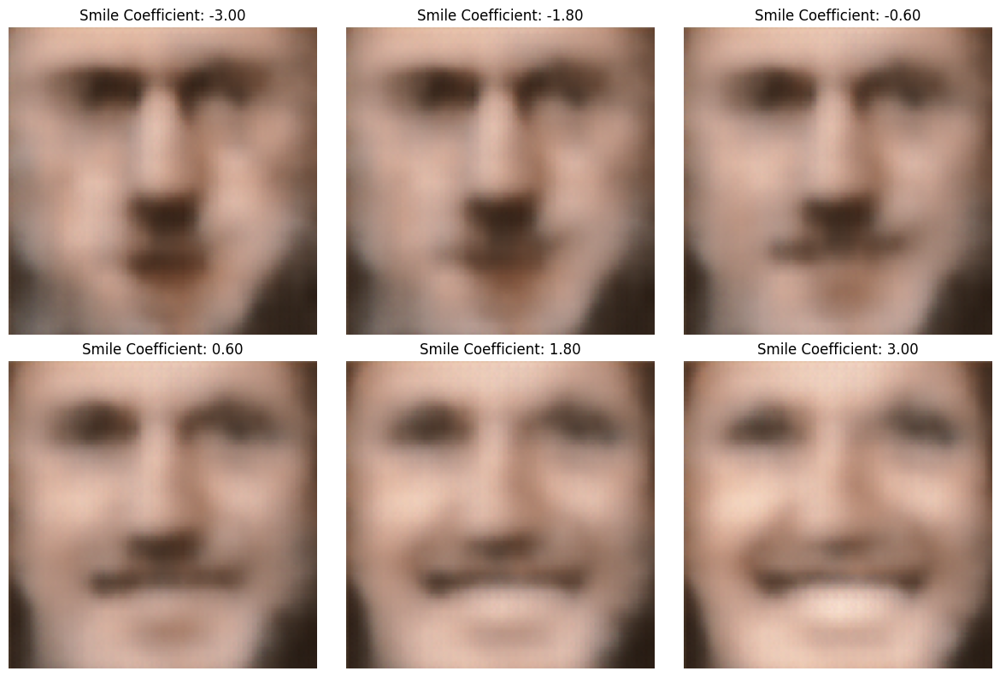

In [ ]:
def calculate_average_latent_vector(vae, dataset):
    latent_vectors = []

    with torch.no_grad():
        for image in dataset:
            image =image.unsqueeze(0)
            _,z_mean, _, _ = vae(image)
            latent_vectors.append(z_mean)

    return torch.mean(torch.stack(latent_vectors), dim=0)

average_z_mean_smile=calculate_average_latent_vector(model, face_dataset_smile)
average_z_mean_non_smile =calculate_average_latent_vector(model, face_dataset_non_smile)

difference_vector=average_z_mean_smile- average_z_mean_non_smile

random_index = random.randint(0, len(face_dataset_non_smile) - 1)
selected_non_smile_image =face_dataset_non_smile[random_index].unsqueeze(0)
_,selected_z_mean, _, _= model(selected_non_smile_image)

smile_coefficients =np.linspace(-3, 3, num=9)
generated_images= []

for coeff in smile_coefficients:
    new_latent_vector= selected_z_mean + coeff * difference_vector
    generated_image=model.decoder(new_latent_vector.unsqueeze(0))
    generated_images.append(generated_image)

plt.figure(figsize=(12,8))
for i,img_tensor in enumerate(generated_images):
    img =img_tensor.squeeze(0).detach().cpu().numpy()
    img =np.transpose(img,(1,2,0))
    plt.subplot(2, 3,i +1)
    plt.imshow(img)
    plt.title(f'Smile Coefficient:{smile_coefficients[i]:.2f}')
    plt.axis('off')
plt.tight_layout()
plt.show()


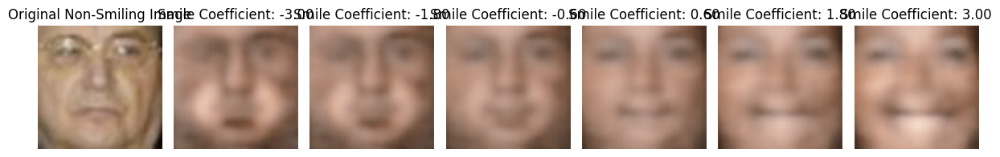

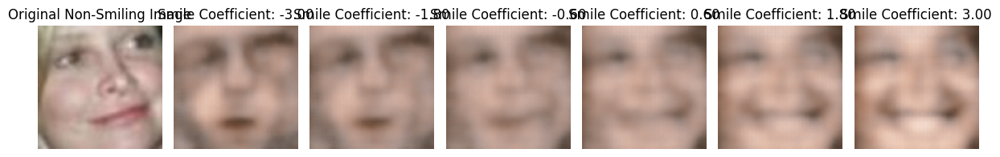

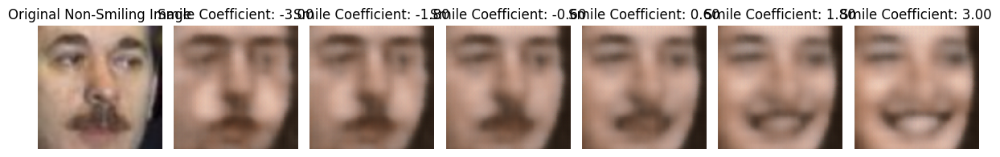

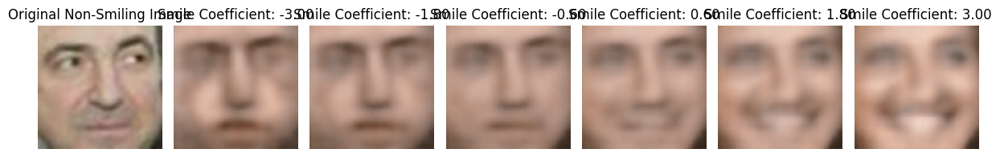

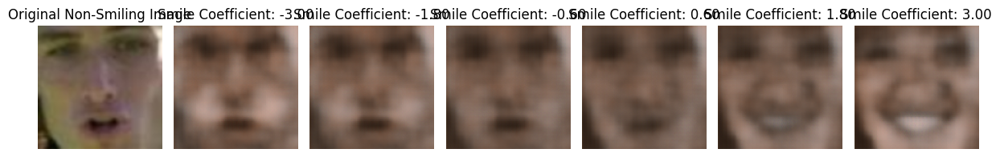

In [ ]:
for i in range(5):
  generate_smiling_images(model, face_dataset_non_smile, face_dataset_smile)